# Analisis Sinyal EMG untuk Gesture 10 pada Session 1: Ekstraksi Fitur dan Persiapan Input untuk Klasifikasi


```
Proyek ini bertujuan untuk mengembangkan metode biometrik berbasis elektromiogram (EMG) sebagai alternatif yang lebih aman dibandingkan biometrik konvensional seperti sidik jari dan pengenalan wajah.
Dengan memanfaatkan sinyal EMG dari otot pergelangan tangan dan lengan bawah, metode ini dapat digunakan untuk identifikasi personal serta autentikasi berbasis gerakan tangan.
Selain itu, teknologi ini juga memungkinkan pengaturan gerakan khusus sebagai kata sandi untuk meningkatkan keamanan.

```

Sumber Data: https://physionet.org/content/grabmyo/1.1.0/



**Anggota Kelompok:**
1.   Andimas Rahmad Sanjaya (NIM)
2.   Moch. Akbar hanafi (NIM)
3.   Nama Lengkap Mahasiswa (NIM)


## Akuisisi Data

```
Penjelasan tentang sinyal tersebut.

1.   Sinyal apakah itu?
     Sinyal yang dimaksud adalah sinyal elektromiogram (EMG), yang diambil dari
     otot-otot pergelangan tangan dan lengan bawah saat melakukan berbagai gerakan tangan dan jari.
     Sinyal ini digunakan untuk pengenalan gestur dan biometrik.

2.   Bagaimana sinyal itu diperoleh? Sinyal tersebut menggambarkan kondisi apa?
     Sinyal diperoleh menggunakan 32 elektroda monopolar yang ditempatkan pada pergelangan tangan dan lengan bawah.
     Elektroda ini diatur dalam konfigurasi bipolar untuk merekam aktivitas otot selama peserta melakukan 16 gerakan
     tangan dan jari yang diinstruksikan secara visual melalui layar komputer. Sinyal ini menggambarkan aktivitas otot
     dan kondisi otot selama gerakan, termasuk potensi aksi yang dihasilkan oleh kontraksi otot.

3.   Informasi apa sajakah yang tersimpan pada sinyal tersebut?
     Informasi yang terkandung meliputi:
      *   Pola aktivitas listrik dari otot yang digunakan selama gestur.
      *   Data temporal dengan sampel diambil pada frekuensi 2048 Hz.
      *   Variasi sinyal antar hari untuk menguji konsistensi penggunaan multi-hari.
      *   Pengaruh faktor seperti kondisi kulit, pergeseran elektroda, dan kondisi fisik (misalnya, saat istirahat atau setelah aktivitas fisik).

4.    Apa perbedaan sinyal dalam kondisi normal dan abnormal?
      *   Kondisi normal: Sinyal menunjukkan pola aktivitas otot yang konsisten dan stabil sesuai dengan gerakan yang diminta.
          Tidak ada gangguan dari faktor eksternal seperti pergeseran elektroda atau perubahan kondisi kulit.
      *   Kondisi abnormal: Sinyal dapat dipengaruhi oleh pergeseran elektroda, perubahan kondisi kulit (kering atau berkeringat), atau kelelahan otot.
          Hal ini menyebabkan variasi dalam pola sinyal yang dapat memengaruhi akurasi pengenalan gestur atau biometrik.

          
```

In [1]:
!pip install wfdb

import wfdb
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq


Defaulting to user installation because normal site-packages is not writeable


## Visualisasi Sinyal

### Domain Waktu

In [2]:
signals = wfdb.rdrecord(r'session1_participant1_gesture10_trial1')

In [3]:
print('1. Nama File:',signals.record_name)
print('\n2. Nama Channel:',signals.sig_name)
print('\n3. Jumlah Channel:',len(signals.sig_name))
print('\n4. Frekuensi Sampel:',signals.fs)
print('\n5. Data Sinyal EMG:\n',signals.p_signal)
print('\n6. Metadata Sinyal:\n',signals.__dict__)


1. Nama File: session1_participant1_gesture10_trial1

2. Nama Channel: ['F1', 'F2', 'F3', 'F4', 'F5', 'F6', 'F7', 'F8', 'F9', 'F10', 'F11', 'F12', 'F13', 'F14', 'F15', 'F16', 'U1', 'W1', 'W2', 'W3', 'W4', 'W5', 'W6', 'U2', 'U3', 'W7', 'W8', 'W9', 'W10', 'W11', 'W12', 'U4']

3. Jumlah Channel: 32

4. Frekuensi Sampel: 2048

5. Data Sinyal EMG:
 [[ 0.01884205  0.003025    0.04645957 ... -0.08056968  0.01084702
   0.00640816]
 [ 0.00708637 -0.00787442  0.00449717 ... -0.11700202 -0.0105317
   0.00566797]
 [-0.01886036 -0.03764184 -0.04017356 ... -0.12352162 -0.02123457
  -0.00460885]
 ...
 [ 0.00110782 -0.0246002  -0.0085931  ...  0.04241974  0.03905467
   0.00115684]
 [ 0.00302132 -0.01872675 -0.00362783 ...  0.04714917  0.03519875
   0.00234999]
 [-0.00272834 -0.0121824  -0.00422968 ...  0.04175447  0.02567608
   0.0048109 ]]

6. Metadata Sinyal:
 {'record_name': 'session1_participant1_gesture10_trial1', 'n_sig': 32, 'fs': 2048, 'counter_freq': None, 'base_counter': None, 'sig_len': 102

In [20]:
len(signals.p_signal)

10240

dengan fs =2048 x 5 detik = 10240

In [4]:
import numpy as np

# Daftar nama channel yang ingin dihapus
unused_channel_names = ['U1', 'U2', 'U3', 'U4']

# Temukan indeks channel yang ingin dihapus
unused_channel_indices = [i for i, name in enumerate(signals.sig_name) if name in unused_channel_names]

# Hapus channel yang tidak digunakan dari data sinyal langsung di variabel 'signals'
signals.p_signal = np.delete(signals.p_signal, unused_channel_indices, axis=1)
signals.sig_name = [name for name in signals.sig_name if name not in unused_channel_names]



In [5]:
amplitudo_max = np.max(signals.p_signal, axis=0)
print('Amplitudo Maksimum per channel:',amplitudo_max)

amplitudo_min = np.min(signals.p_signal, axis=0)
print('\nAmplitudo Minimum per channel:',amplitudo_min)

amplitudo_range = amplitudo_max - amplitudo_min
print('\nRange Amplitudo:',amplitudo_range)



Amplitudo Maksimum per channel: [0.26013559 0.36996817 0.51015245 0.50581145 0.49421104 0.36788925
 0.27981609 0.23138575 0.27755678 0.41449344 0.47034098 0.49121863
 0.46564111 0.42827439 0.27834407 0.24656628 0.25766681 0.23130594
 0.2675974  0.2666238  0.54648606 0.35740027 0.2037553  0.13337782
 0.12298341 0.18743367 0.55693593 0.40428567]

Amplitudo Minimum per channel: [-0.33984348 -0.40137167 -0.585434   -0.75053109 -0.48819962 -0.54087167
 -0.29433345 -0.32963993 -0.35223889 -0.48004251 -0.52855248 -0.70591898
 -0.58209935 -0.50310232 -0.33879305 -0.34094156 -0.35262953 -0.24198038
 -0.34779399 -0.43769163 -0.23531779 -0.21278528 -0.19011191 -0.21067449
 -0.17426052 -0.16216795 -0.23573374 -0.18609303]

Range Amplitudo: [0.59997906 0.77133984 1.09558644 1.25634254 0.98241066 0.90876092
 0.57414954 0.56102568 0.62979567 0.89453595 0.99889347 1.19713761
 1.04774047 0.93137671 0.61713712 0.58750784 0.61029635 0.47328633
 0.61539139 0.70431543 0.78180385 0.57018555 0.39386721 0.344

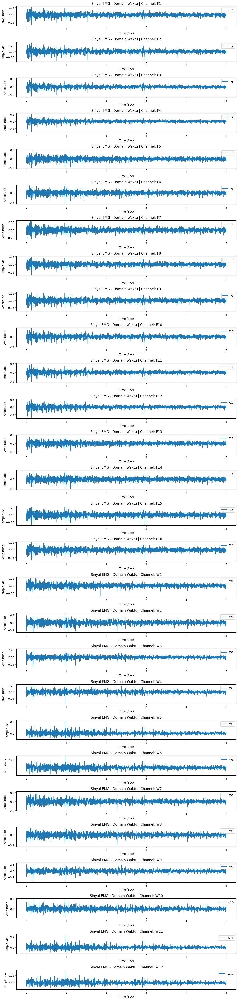

In [6]:

signal = signals.p_signal
sampling_rate = 2048
num_channels = signal.shape[1]
channel_names = signals.sig_name

time = np.linspace(0, len(signal) / sampling_rate, len(signal))

plt.figure(figsize=(12, 50))
for i in range(signal.shape[1]):
    plt.subplot(signal.shape[1], 1, i + 1)
    plt.plot(time, signal[:, i], label=channel_names[i])
    plt.title(f'Sinyal EMG - Domain Waktu | Channel: {channel_names[i]}')
    plt.xlabel('Time (Sec)')
    plt.ylabel('Amplitude')
    plt.legend(loc='upper right')

plt.tight_layout()
plt.show()



**Berdasarkan hasil plotting diatas dapat ditarik kesimpulan sebagai berikut:**

1.   Sumbu X (Time)

     Berdasarkan hasil visualisasi didapatkan bahwa waktu pengambilan data menggunakan sencor untuk setiap channel adalah 5 Sec.
2.   Sumbu Y (Amplitudo)

     Hasil dari setiap channel menunjukan pola sinyal yang berbeda dalam hal ini adalah Amplitudo (Kekuatan sinyal), hal ini bisa disebabkan oleh variasi aktivitas otot karna perbedaan lokasi untuk setiap sensor.





### Domain Frekuensi

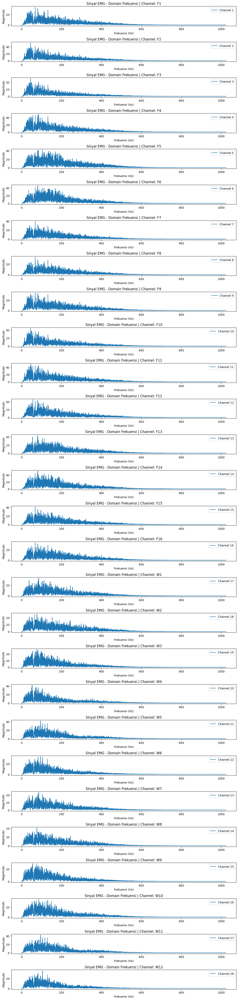

In [7]:
# Transformasikan sinyal tersebut ke dalam domain frekuensi
# Gunakan modul scipy.fft
from scipy.fft import fft, fftfreq

freq = fftfreq(len(signal), d=1/sampling_rate)

plt.figure(figsize=(12, 50))
for i in range(signal.shape[1]):
    fft_signal = fft(signal[:, i])
    magnitude = np.abs(fft_signal)
    plt.subplot(signal.shape[1], 1, i + 1)
    plt.plot(freq[:len(freq)//2], magnitude[:len(freq)//2], label=f"Channel {i + 1}")
    plt.title(f'Sinyal EMG - Domain Frekuensi | Channel: {channel_names[i]}')
    plt.xlabel('Frekuensi (Hz)')
    plt.ylabel('Magnitudo')
    plt.legend(loc='upper right')

plt.tight_layout()
plt.show()




**Berdasarkan hasil plotting diatas dapat ditarik kesimpulan sebagai berikut:**

1.   Sumbu X (Frekuensi)

     Berdasarkan plot diatas dapat dilihat bahwa semua channel merekam data pada frekuensi 0-600 Hz, hal ini wajar untuk sinyal EMG sebab aktivitas otot biasanya mendominasi pada rentang frekuensi 20-500 Hz.
2.   Sumbu Y (Magnitudo)

     Dapat dilihat pada hasil plot bahwa semua channel memiliki nilai Magnitudo (Besar fluktuasi pada waktu tertentu) tertinggi pada rentang frekuensi 0-200 Hz, hal ini disebabkan kerna otot memang bekerja pada rentang frekuensi rendah 20-500 Hz.

  





###DOMAIN WAKTU-FREKUENSI

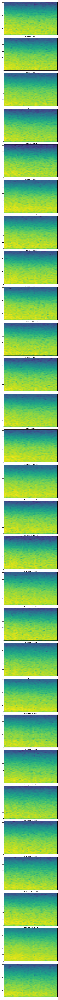

In [8]:
#Visualisasi sinyal ke domain waktu frekuensi
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import spectrogram

num_channels = signals.p_signal.shape[1]
fig, axes = plt.subplots(num_channels, 1, figsize=(10, 6 * num_channels), sharex=True)

for i in range(num_channels):
    # Ambil data sinyal untuk channel saat ini
    signal = signals.p_signal[:, i]

    frequencies, times, Sxx = spectrogram(signal, fs=signals.fs)

    if np.any(Sxx):
        mesh = axes[i].pcolormesh(times, frequencies, 10 * np.log10(Sxx), shading='gouraud')
        axes[i].set_ylabel('Frequency [Hz]')
        axes[i].set_title(f'Spectrogram - Channel {signals.sig_name[i]}')
    else:
        print(f"Warning: Spectrogram data for channel {signals.sig_name[i]} is empty or zero. Skipping plot.")

axes[-1].set_xlabel('Time [sec]')
image_for_colorbar = None
for ax in axes:
    if ax.images:
        image_for_colorbar = ax.images[0]
        break
if image_for_colorbar:
    fig.colorbar(image_for_colorbar, ax=axes, label='Power/Frequency [dB/Hz]')

plt.tight_layout()
plt.show()

Sumbu X (Waktu): Merepresentasikan waktu dalam detik. .

Sumbu Y (Frekuensi): Merepresentasikan frekuensi dalam Hertz (Hz). Semakin tinggi posisi pada sumbu y, semakin tinggi frekuensi komponen sinyal EMG.

Warna: Merepresentasikan kekuatan atau intensitas sinyal (power spectral density) pada kombinasi waktu dan frekuensi tertentu. Warna yang lebih hangat seperti kuning pada visualisasi menunjukkan intensitas sinyal yang lebih tinggi, sementara warna yang lebih dingin misalnya biru  menunjukkan intensitas sinyal yang lebih rendah.

Dari visualisasi diatas sesuai karakteristik sinyal EMG dimana sebagian besar energi sinyak (intensitas tinggi yang berwawrna kuning hingga hijau terang terkonsentrasi pada rentang sekitar(0.5 - 500 hz)

## Pra-Pemrosesan

```
-Filtering menggunakan ButterWorth Filter
-Normalisasi Min-Max dan Z-Score
-Detrending
```

### Filtering

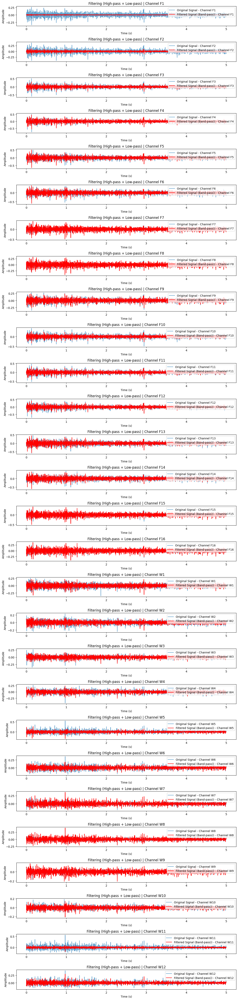

In [34]:
from scipy.signal import butter, lfilter, detrend, welch

def butter_filter(data, cutoff, fs, filter_type='low', order=4):
    nyquist = 0.5 * fs  # Frekuensi Nyquist
    normal_cutoff = cutoff / nyquist
    b, a = butter(order, normal_cutoff, btype=filter_type, analog=False)
    filtered_signal = lfilter(b, a, data)
    return filtered_signal

# Penerapan Filter
low_cutoff = 500  # Frekuensi batas low-pass (Hz)
high_cutoff = 0.5  # Frekuensi batas high-pass (Hz)

high_passed = butter_filter(signals.p_signal, high_cutoff, sampling_rate, filter_type='high')
band_passed = butter_filter(high_passed, low_cutoff, sampling_rate, filter_type='low')



# Visualisasi Hasil Filtering
plt.figure(figsize=(12, 50))
for i in range(num_channels):
    plt.subplot(num_channels, 1, i + 1)
    plt.plot(time, signals.p_signal[:, i], label=f'Original Signal - Channel {channel_names[i]}', alpha=0.7)
    plt.plot(time, band_passed[:, i], label=f'Filtered Signal (Band-pass)) - Channel {channel_names[i]}', color='red', linewidth=1.5)
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title(f'Filtering (High-pass + Low-pass) | Channel {channel_names[i]}')
    plt.legend(loc='upper right')

plt.tight_layout()
plt.show()


High-pass filter digunakan pertama untuk memfilter sinyal dengan cutoff pada 0.5 Hz (frekuensi rendah dibuang).
Low-pass filter digunakan setelahnya pada hasil filtering high-pass untuk memfilter sinyal dengan cutoff pada 500 Hz (frekuensi tinggi dibuang).
Sinyal yang sudah diproses ini disebut sebagai band-pass filter karena menyaring frekuensi di antara 0,5 hz - 500 hz


### SNR

In [36]:
drift_baseline = butter_filter(signals.p_signal, high_cutoff, sampling_rate, filter_type='low')
noise_electrodes = butter_filter(signals.p_signal, low_cutoff, sampling_rate, filter_type='high')
noise = drift_baseline + noise_electrodes

def snr(signal, noise):
    signal_power = np.sum(signal ** 2)
    noise_power = np.sum(noise ** 2)
    return 10 * np.log10(signal_power / noise_power)

snr_values = snr(signals.p_signal, noise)
print(f'SNR per channel:, {snr_values:.2f} db')


SNR per channel:, 10.40 db


dalam hal ini nilai snr yang didapat termasuk masih dapat diterima, menurut web https://delsys.com/emgworks/signal-quality-monitor/improve sinyal SNR > 1.2 acceptable(diterima)

### Normalisasi


Guna untuk menyamakan rentang nilai sinyal

#### MIN MAX 

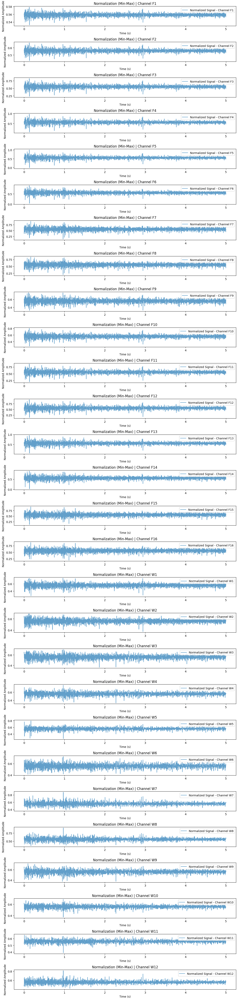

In [37]:
def normalize_signal(data, method='min-max'):
    if method == 'min-max':
        return (data - np.min(data)) / (np.max(data) - np.min(data))
    elif method == 'z-score':
        return (data - np.mean(data)) / np.std(data)

# Penerapan Normalisasi
normalized_signal = normalize_signal(band_passed, method='min-max')

# Visualisasi Normalisasi
plt.figure(figsize=(12, 50))
for i in range(num_channels):
    plt.subplot(num_channels, 1, i + 1)
    plt.plot(time, normalized_signal[:, i], label=f'Normalized Signal - Channel {channel_names[i]}', alpha=0.7)
    plt.xlabel('Time (s)')
    plt.ylabel('Normalized Amplitude')
    plt.title(f'Normalization (Min-Max) | Channel {channel_names[i]}')
    plt.legend(loc='upper right')

plt.tight_layout()
plt.show()


####Z-SCORE

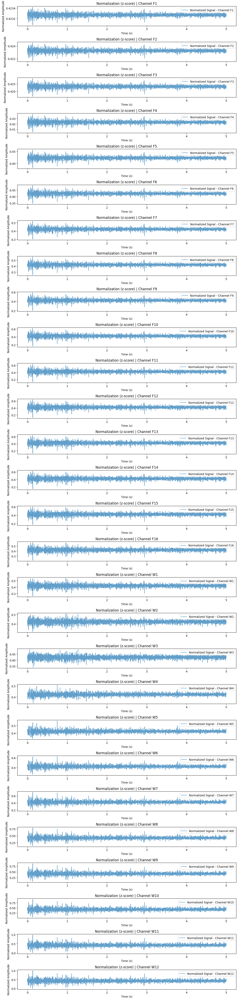

In [11]:
# Penerapan Normalisasi
normalized_signal_z = normalize_signal(band_passed, method='z-score')

# Visualisasi Normalisasi
plt.figure(figsize=(12, 50))
for i in range(num_channels):
    plt.subplot(num_channels, 1, i + 1)
    plt.plot(time, normalized_signal[:, i], label=f'Normalized Signal - Channel {channel_names[i]}', alpha=0.7)
    plt.xlabel('Time (s)')
    plt.ylabel('Normalized Amplitude')
    plt.title(f'Normalization (z-score) | Channel {channel_names[i]}')
    plt.legend(loc='upper right')

plt.tight_layout()
plt.show()


### Detrending

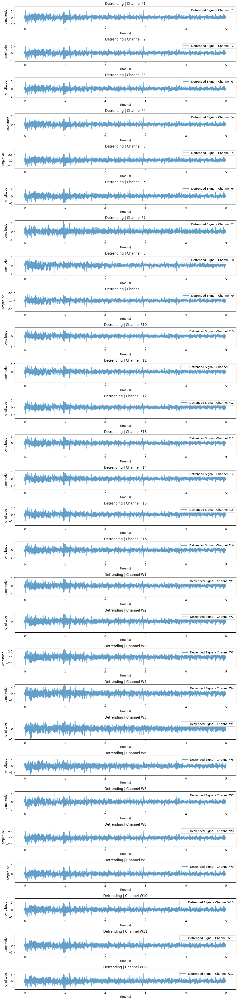

In [12]:
detrended_signal = detrend(normalized_signal_z)

# Visualisasi Detrended Signal
plt.figure(figsize=(12, 50))
for i in range(num_channels):
    plt.subplot(num_channels, 1, i + 1)
    plt.plot(time, detrended_signal[:, i], label=f'Detrended Signal - Channel {channel_names[i]}', alpha=0.7)
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.title(f'Detrending | Channel {channel_names[i]}')
    plt.legend(loc='upper right')

plt.tight_layout()
plt.show()


### Transformasi Domain Frekuensi

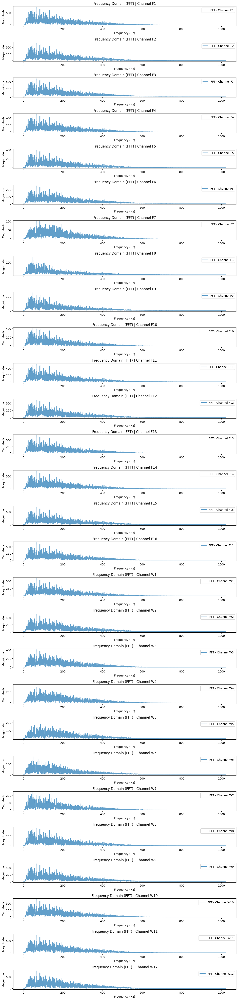

In [13]:
from scipy.fft import fft, fftfreq

# FFT
freq = fftfreq(len(detrended_signal), d=1 / sampling_rate) # Frekuensi positif

# Visualisasi Spektrum Frekuensi
plt.figure(figsize=(12, 50))
for i in range(num_channels):
    fft_signal = fft(detrended_signal[:, i])
    magnitude = np.abs(fft_signal)
    plt.subplot(num_channels, 1, i + 1)
    plt.plot(freq[:len(freq)//2], magnitude[:len(freq)//2], label=f'FFT - Channel {channel_names[i]}', alpha=0.7)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude')
    plt.title(f'Frequency Domain (FFT) | Channel {channel_names[i]}')
    plt.legend(loc='upper right')

plt.tight_layout()
plt.show()


Karena Sinyal EMG adalah sinyal yang tidak stasioner atau sinyal yang tidak konstan sepanjang waktu , maka disini kami menggunakan Transformasi Wavelet ,untuk transformasi ke domain waktu-frequency

###TRANSFORMASI DOMAIN TIME-FRQUENCY

In [14]:
!pip install PyWavelets


Defaulting to user installation because normal site-packages is not writeable


Dengan 4 tingkat dekomposisi , dan Daubechies 4 yang paling umum digunakan dalam pengolahan sinyal EMG

https://journal.uii.ac.id/jurnal-teknoin/article/download/10637/8257/22249

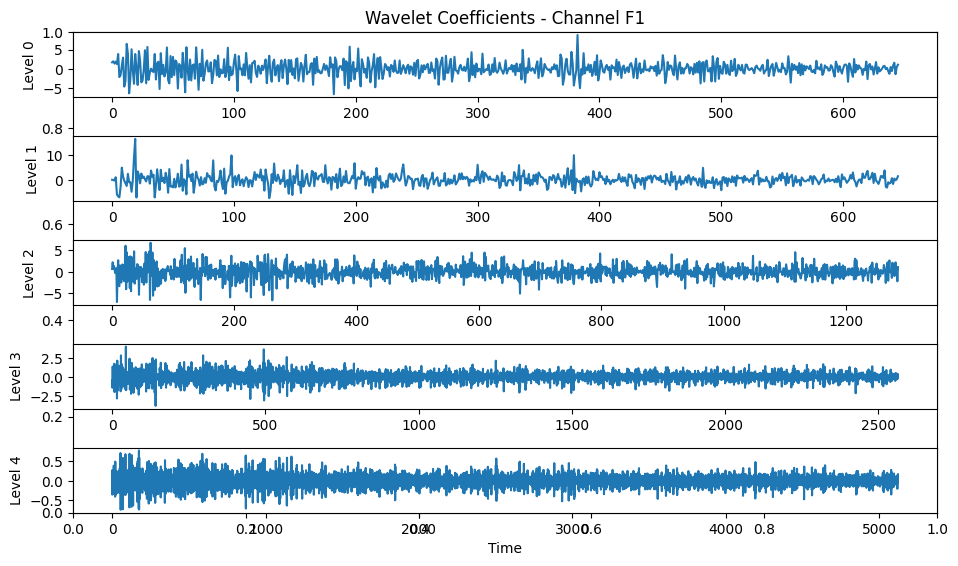

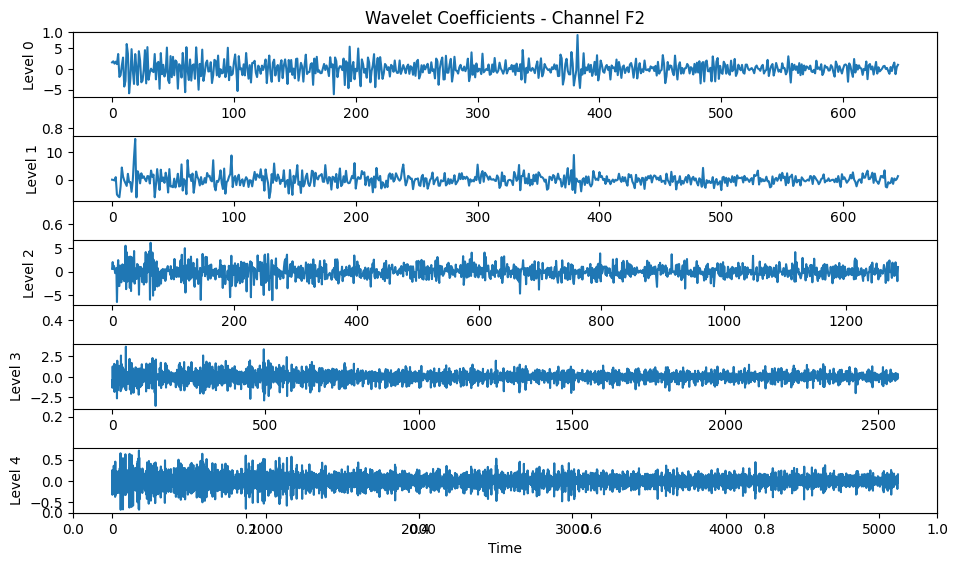

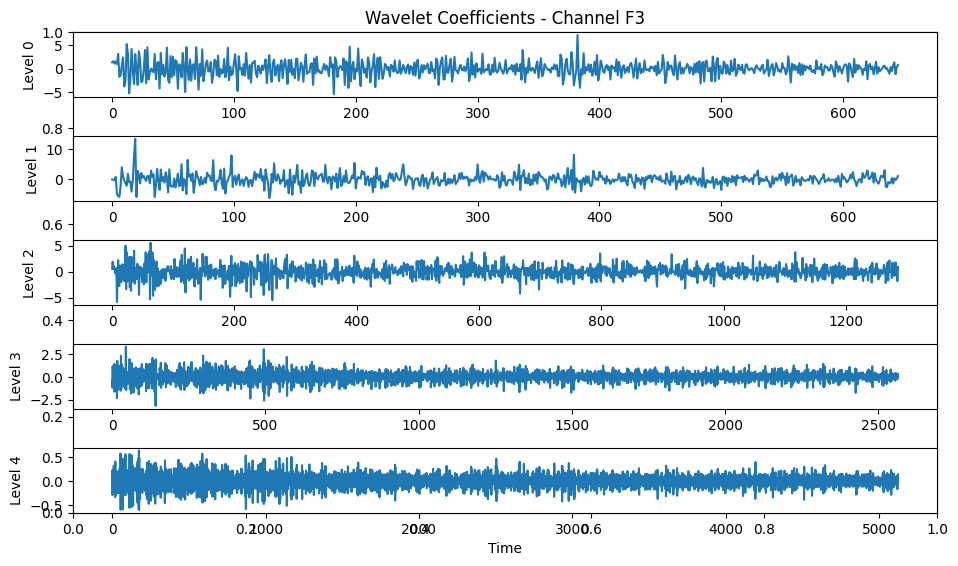

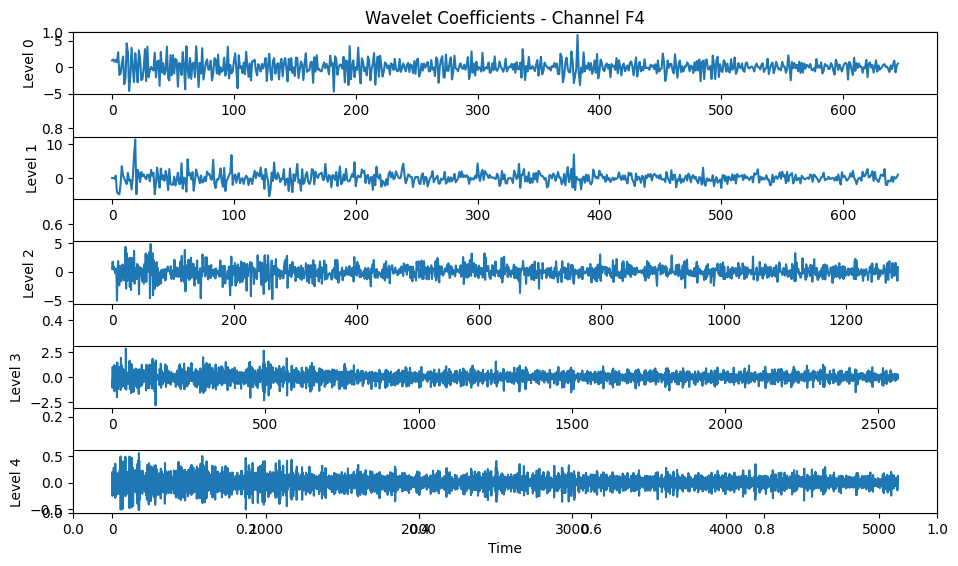

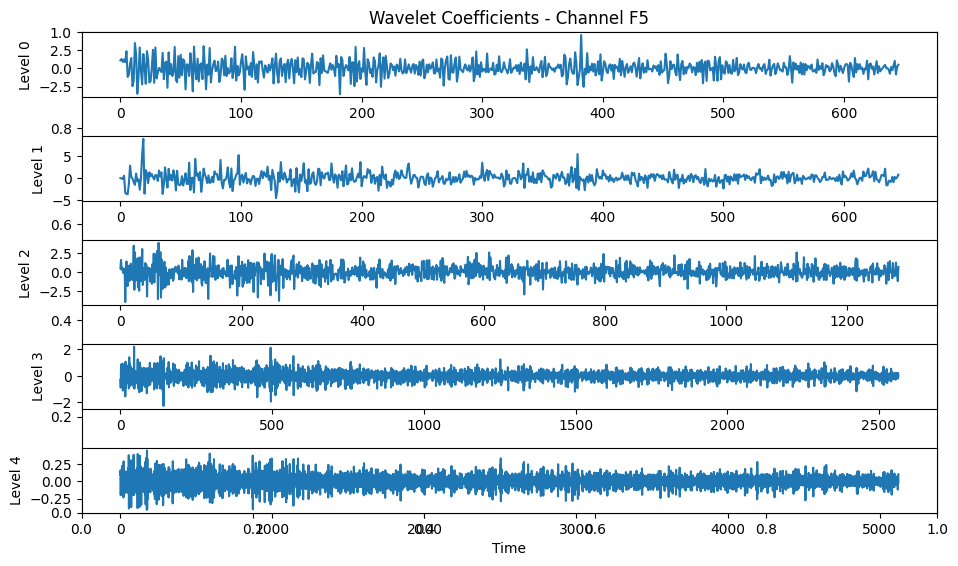

...

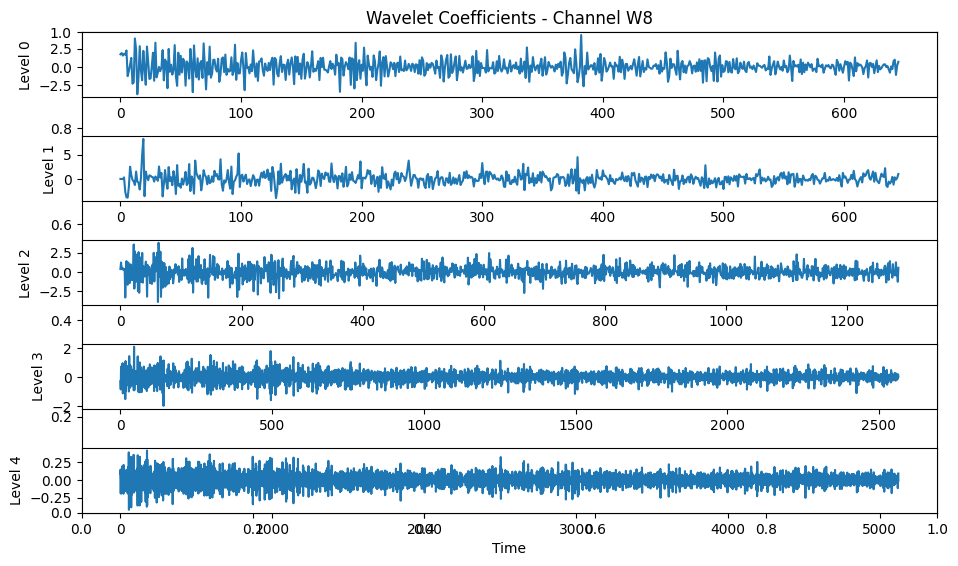

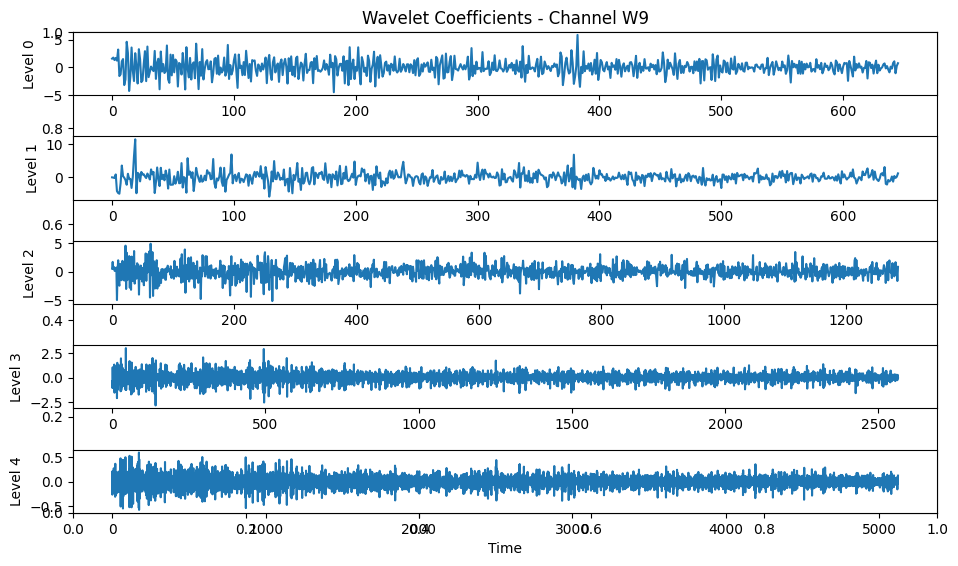

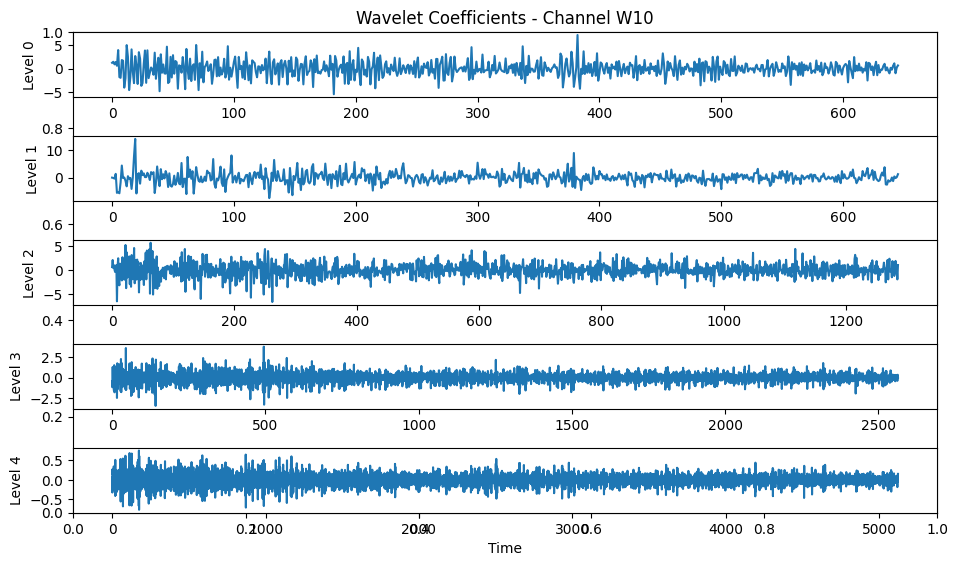

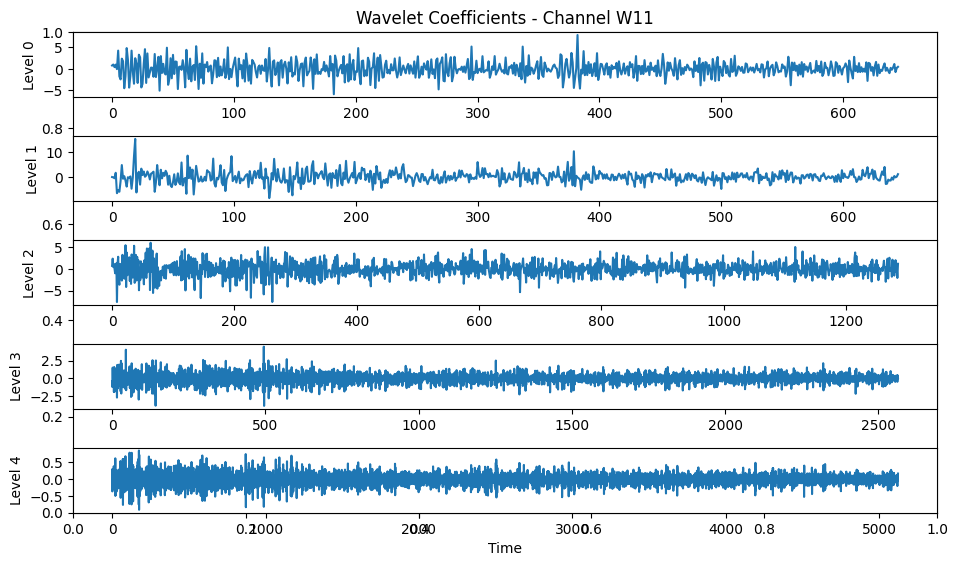

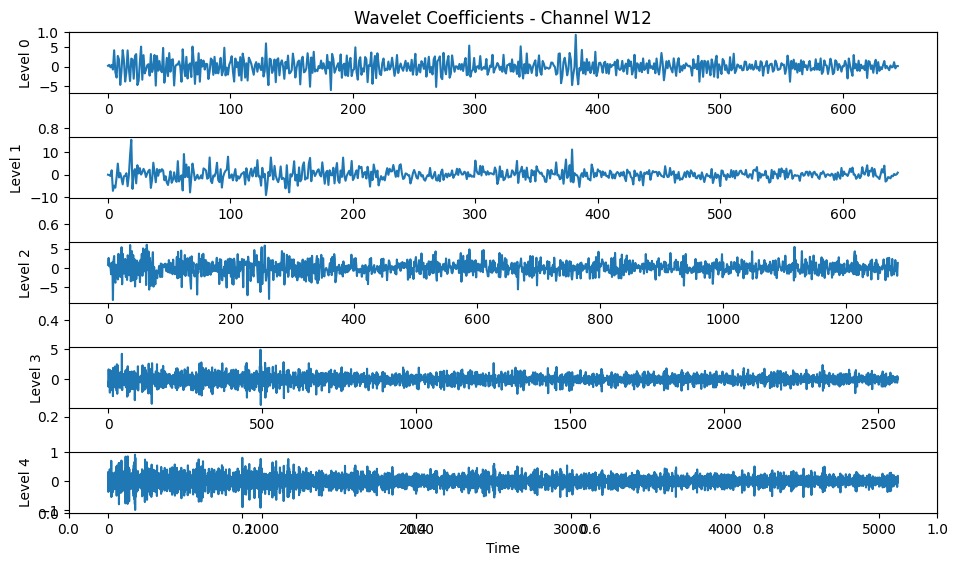

In [15]:
import pywt
import matplotlib.pyplot as plt

# Pilih wavelet dan level dekomposisi
wavelet = 'db4'
level = 4

for i in range(detrended_signal.shape[1]):
    # Dekomposisi wavelet
    coeffs = pywt.wavedec(detrended_signal[:, i], wavelet, level=level)

    # Visualisasi koefisien wavelet
    plt.figure(figsize=(10, 6))
    plt.title(f"Wavelet Coefficients - Channel {channel_names[i]}")

    for j, c in enumerate(coeffs):
        plt.subplot(len(coeffs), 1, j + 1)
        plt.plot(c)
        plt.ylabel(f"Level {j}")

    plt.xlabel("Time")
    plt.tight_layout()
    plt.show()



Menggunakan hanya koefisien D3/level 3 karena koefisien D3 menangkap komponen frekuensi tinggi yang sensitif terhadap perubahan cepat dalam sinyal. Pada sinyal EMG

Pada level 3, D3 menangkap detail menengah, yang memungkinkan model untuk mendeteksi transisi cepat dalam data yang mungkin tidak terdeteksi pada level yang lebih tinggi (misalnya, D4) yang menangkap detail lebih kasar. Koefisien D3 ideal untuk fitur-fitur transien dan cepat yang sangat berguna dalam aplikasi klasifikasi, seperti mendeteksi gerakan atau pola aktivitas otot dalam EMG.

### Windowing / segmentasi beserta ekstraksi fitur

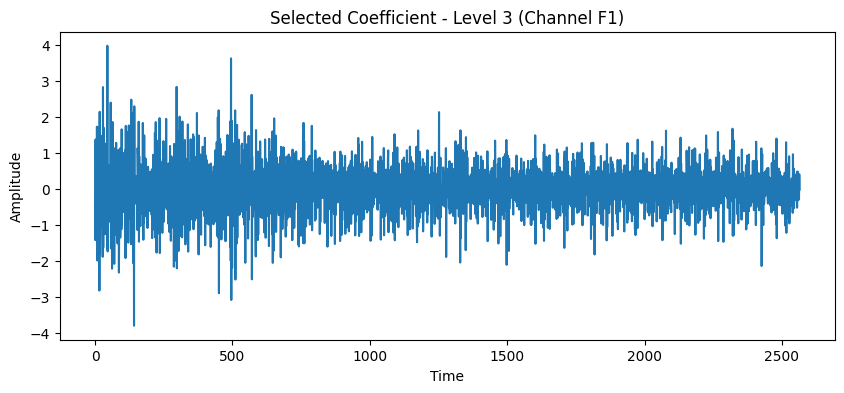

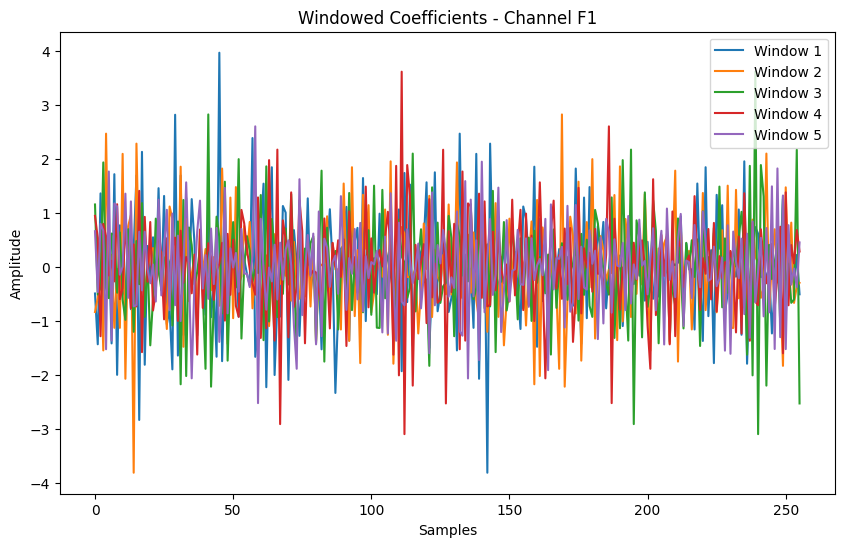

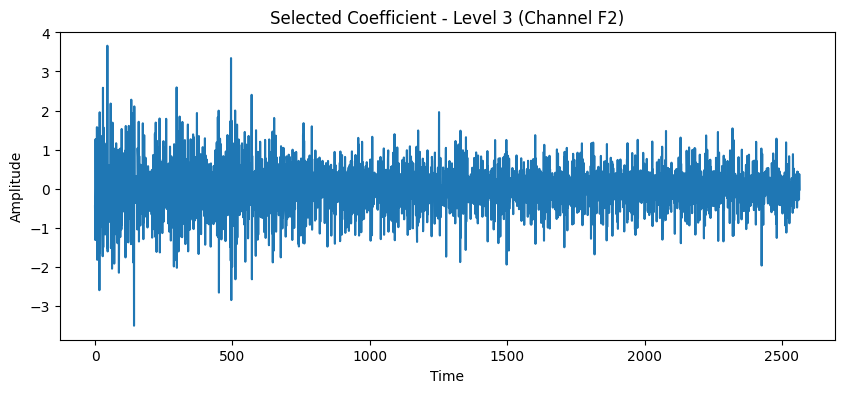

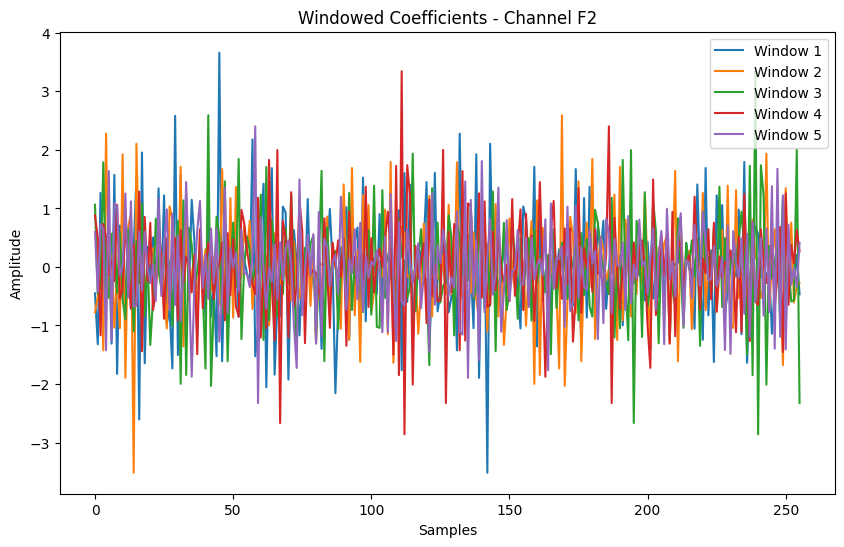

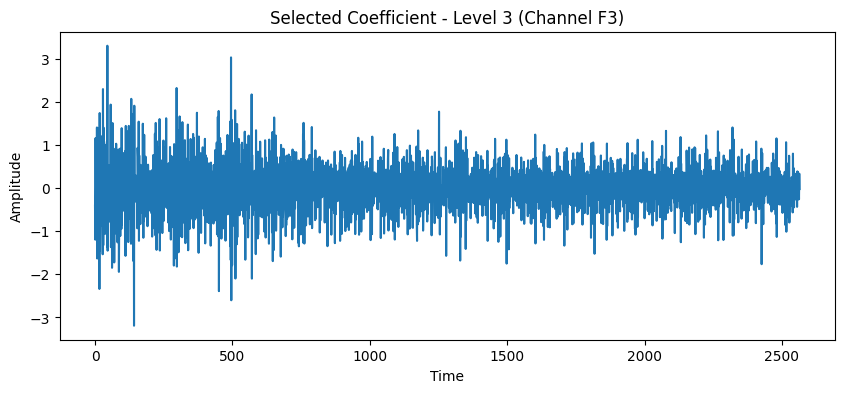

...

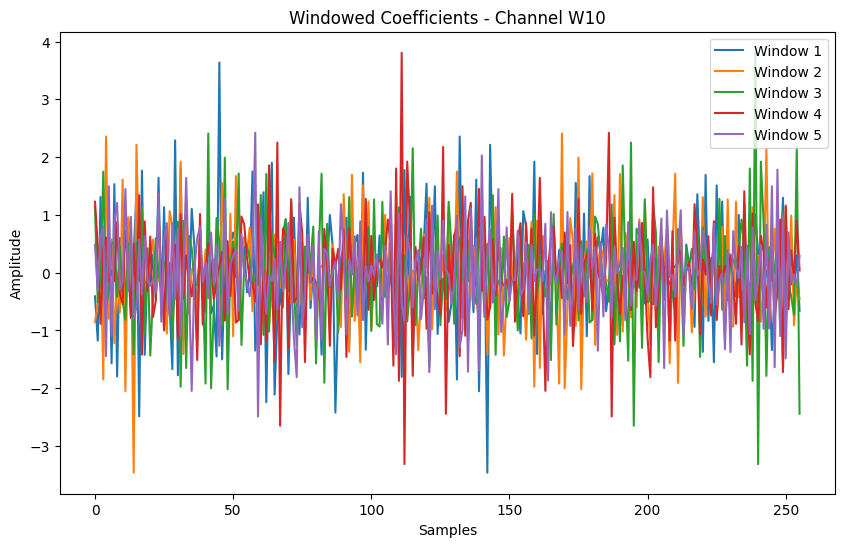

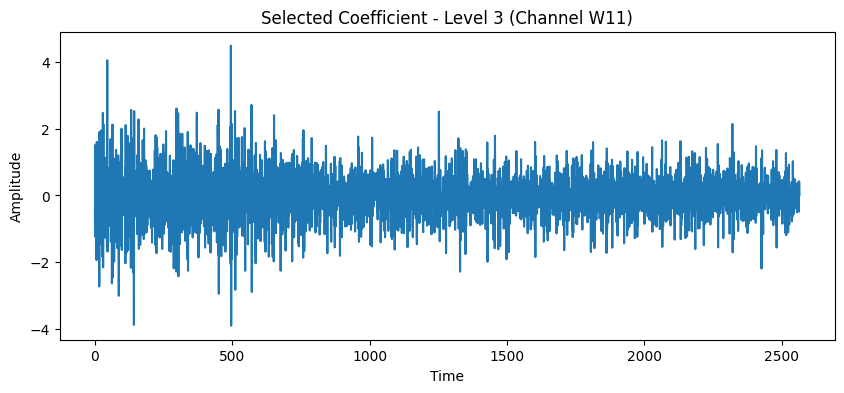

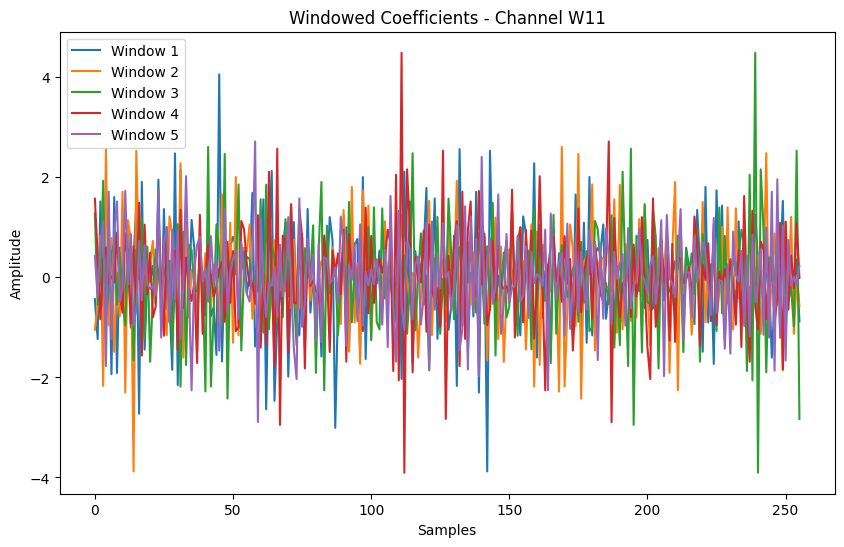

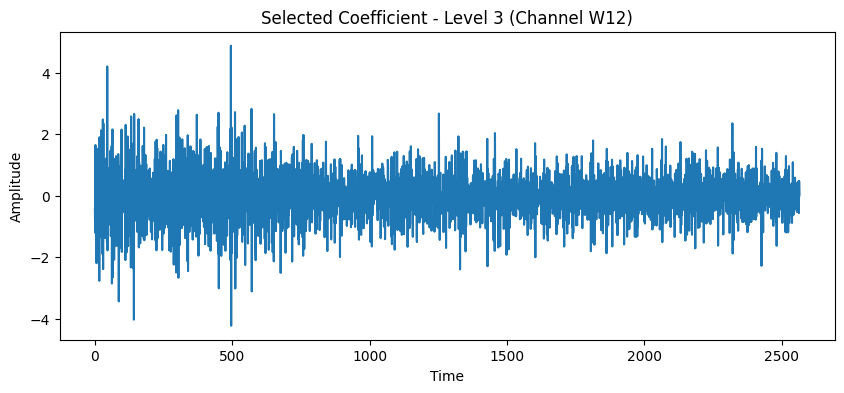

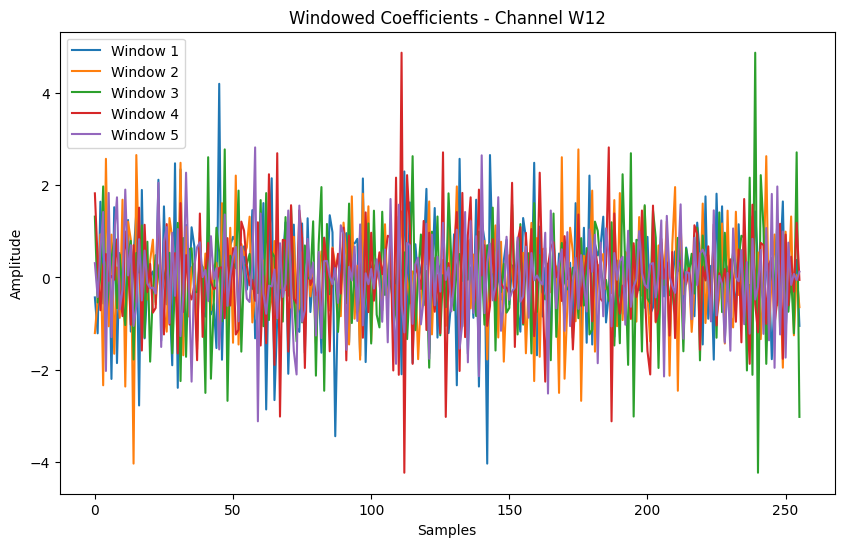

In [16]:
import numpy as np

window_size = 256
step_size = 128
for i in range(detrended_signal.shape[1]):
    # Dekomposisi wavelet
    coeffs = pywt.wavedec(detrended_signal[:, i], wavelet, level=level)


    selected_coeff = coeffs[3]  # Level 3 /D3

    plt.figure(figsize=(10, 4))
    plt.plot(selected_coeff)
    plt.title(f"Selected Coefficient - Level 3 (Channel {channel_names[i]})")
    plt.xlabel("Time")
    plt.ylabel("Amplitude")
    plt.show()

    # Lakukan windowing pada koefisien yang dipilih
    windows = []
    for start in range(0, len(selected_coeff) - window_size + 1, step_size):
        # Ambil satu window
        window = selected_coeff[start:start + window_size]
        windows.append(window)

    windows = np.array(windows)  # Konversi menjadi array


    # Visualisasi beberapa window
    plt.figure(figsize=(10, 6))
    plt.title(f"Windowed Coefficients - Channel {channel_names[i]}")
    for w_idx in range(min(len(windows), 5)):  # Plot hanya 5 window pertama
        plt.plot(windows[w_idx], label=f"Window {w_idx + 1}")
    plt.xlabel("Samples")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.show()



Windowing membagi koefisien wavelet (atau sinyal asli) menjadi segmen-segmen kecil agar analisis bisa dilakukan pada segmen tersebut.

 Setiap window dapat diekstrak fitur-fitur yang menggambarkan karakteristik sinyal pada segmen waktu tertentu, seperti RMS, mean, atau fitur frekuensi.

## Ekstraksi Fitur


berdasarkan paper yang berjudul: **EMG-Based Feature Extraction and Classification for Prosthetic Hand Control**

https://arxiv.org/pdf/2107.00733

Dalam paper menyebutkan bahwa terdapat Conventional Features yang biasa digunakan dalam analisis sinyal EMG yaitu :

* Integrated EMG (IEMG)
* Mean Absolute Value (MAV)
* Simple Square Integrated (SSI)
* Root Mean Square (RMS)
* Variance (VAR)
* Myopulse Percentage Rate (MYOP)
* Waveform Length (WL)
* Difference Absolute Mean Value (DAMV)
* Second-Order Moment (M2)
* Difference Variance Version (DVARV)
* Difference Absolute Standard Deviation Value (DASDV)
* Willison Amplitude (WAMP)



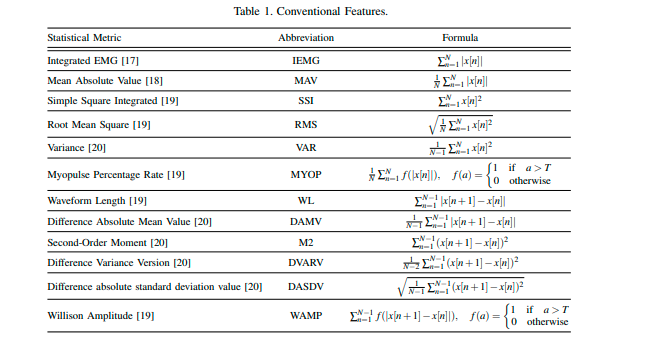

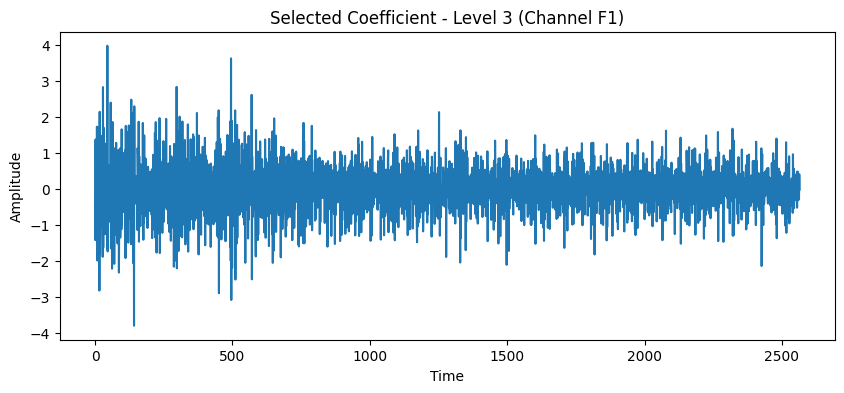

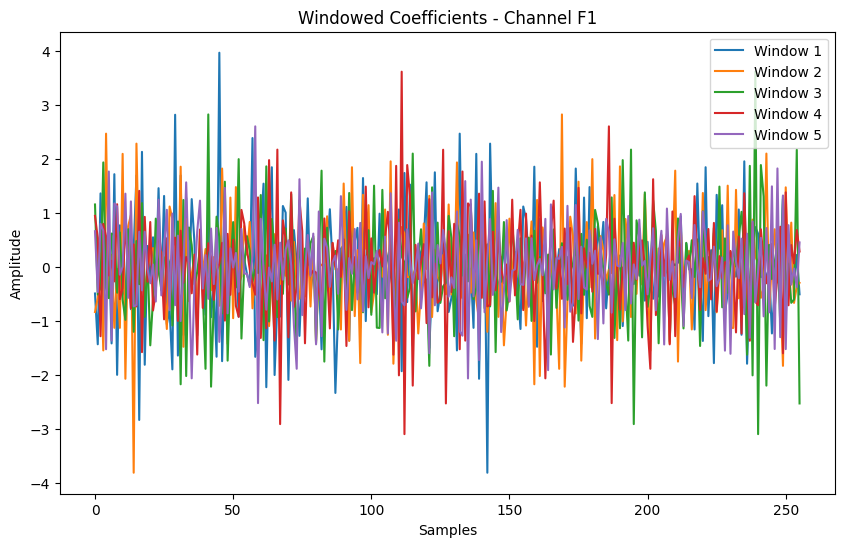

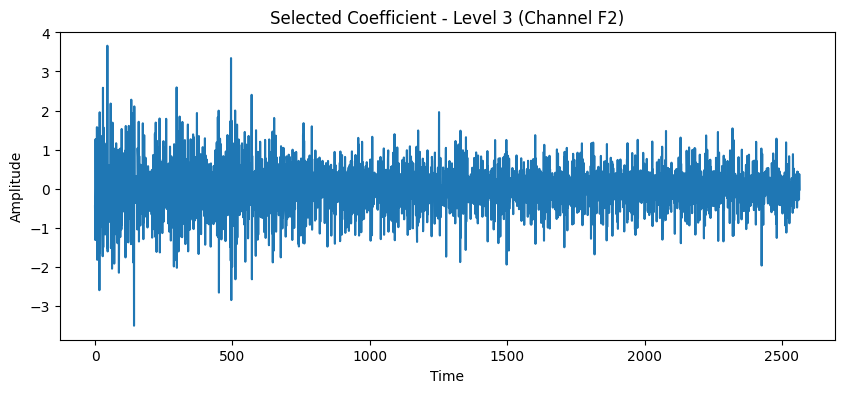

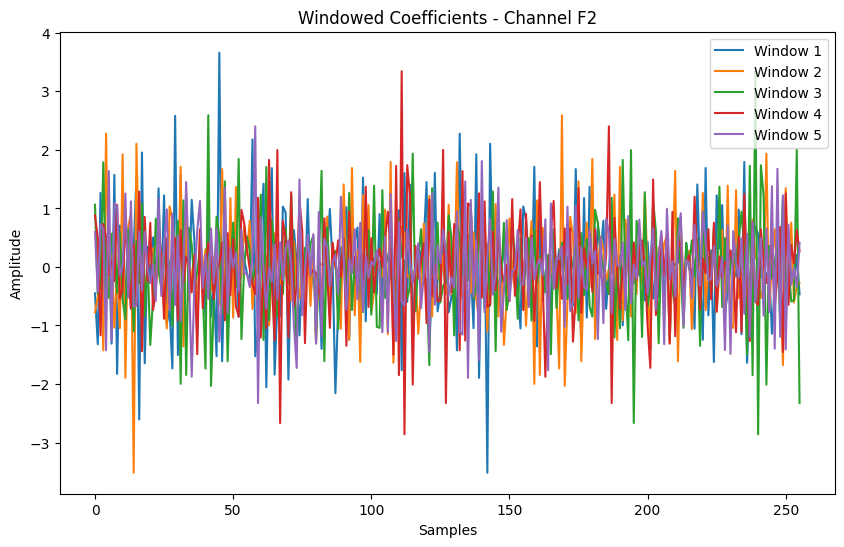

...

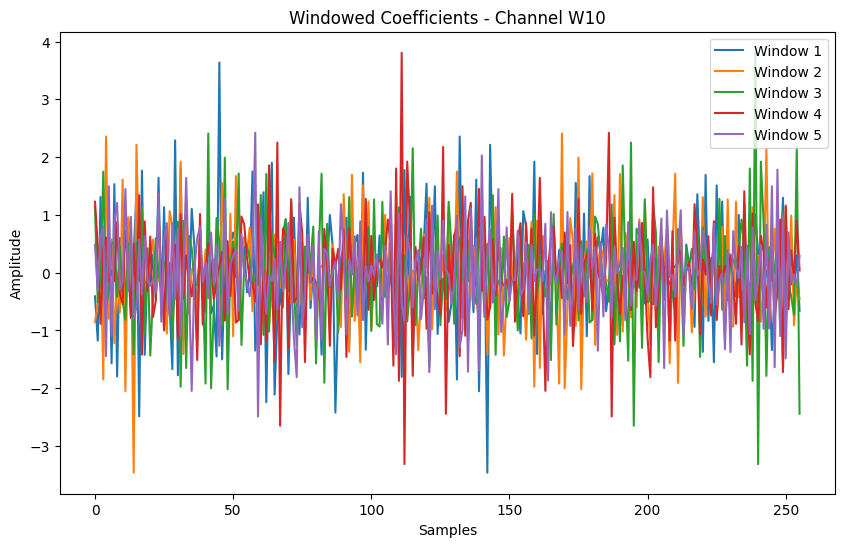

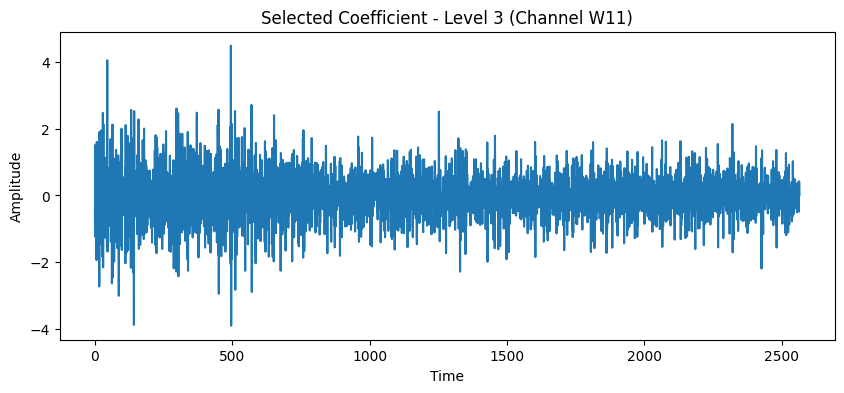

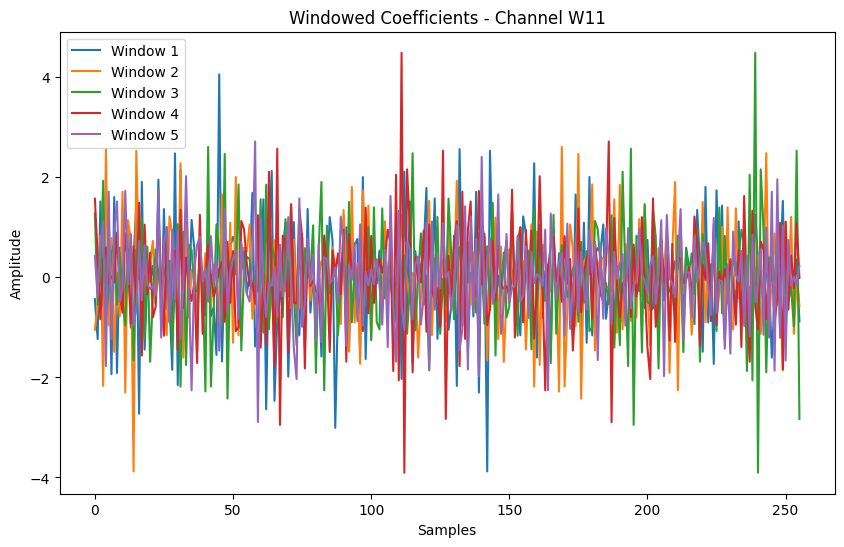

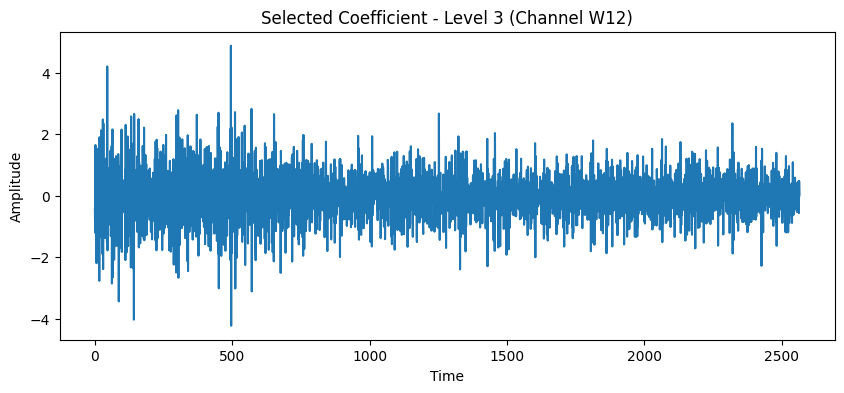

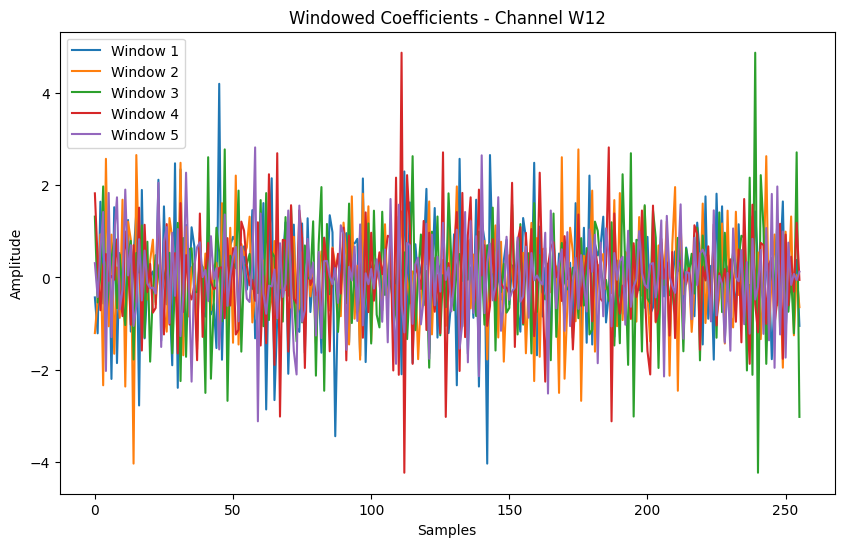

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import pywt

window_size = 256
step_size = 128
features = []

# Conv. Features berdasarkan paper
def extract_features(window):
    # 1. Integrated EMG (IEMG)
    iemg = np.sum(np.abs(window))

    # 2. Mean Absolute Value (MAV)
    mav = np.mean(np.abs(window))

    # 3. Simple Square Integrated (SSI)
    ssi = np.sum(window**2)

    # 4. Root Mean Square (RMS)
    rms = np.sqrt(np.mean(window**2))

    # 5. Variance (VAR)
    var = np.var(window)

    # 6. Myopulse Percentage Rate (MYOP)
    myop = np.sum(window > 0) / len(window) * 100

    # 7. Waveform Length (WL)
    wl = np.sum(np.abs(np.diff(window)))

    # 8. Difference Absolute Mean Value (DAMV)
    damv = np.mean(np.abs(np.diff(window)))

    # 9. Second-Order Moment (M2)
    m2 = np.mean(window**2)

    # 10. Difference Variance Version (DVARV)
    dvarv = np.var(np.diff(window))

    # 11. Difference Absolute Standard Deviation Value (DASDV)
    dasdv = np.std(np.diff(window))

    # 12. Willison Amplitude (WAMP)
    wamp = np.sum(np.abs(np.diff(window)) > 0.1)

    return [iemg, mav, ssi, rms, var, myop, wl, damv, m2, dvarv, dasdv, wamp]

for i in range(detrended_signal.shape[1]):
    # Dekomposisi wavelet
    coeffs = pywt.wavedec(detrended_signal[:, i], wavelet, level=level)

    selected_coeff = coeffs[3]  # Level 3

    plt.figure(figsize=(10, 4))
    plt.plot(selected_coeff)
    plt.title(f"Selected Coefficient - Level 3 (Channel {channel_names[i]})")
    plt.xlabel("Time")
    plt.ylabel("Amplitude")
    plt.show()

    # Lakukan windowing pada koefisien yang dipilih
    windows = []
    for start in range(0, len(selected_coeff) - window_size + 1, step_size):
        # Ambil satu window
        window = selected_coeff[start:start + window_size]
        windows.append(window)

    windows = np.array(windows)  # Konversi menjadi array

    # Ekstraksi fitur untuk setiap window
    for window in windows:
        feature = extract_features(window)
        features.append(feature)

    # Visualisasi beberapa window
    plt.figure(figsize=(10, 6))
    plt.title(f"Windowed Coefficients - Channel {channel_names[i]}")
    for w_idx in range(min(len(windows), 5)):
        plt.plot(windows[w_idx], label=f"Window {w_idx + 1}")
    plt.xlabel("Samples")
    plt.ylabel("Amplitude")
    plt.legend()
    plt.show()


In [18]:
print("Sample extracted features: ", features[:5])

Sample extracted features:  [[207.36678550866023, 0.810026505893204, 285.96765452051557, 1.05691113650617, 1.1166256260928928, 48.046875, 362.72163506360744, 1.4224377845631664, 1.117061150470764, 3.4362534382856844, 1.8537134185967594, 244], [184.15393249924435, 0.7193512988251732, 227.93326861537076, 0.9435911882424465, 0.8900597184586929, 47.265625, 326.77383201554005, 1.2814660079040787, 0.890364330528792, 2.7378277661343993, 1.6546382583919663, 242], [196.0741317535873, 0.7659145771624504, 250.55475678341162, 0.9893075955865303, 0.9786460785534529, 50.390625, 345.1397801645123, 1.3534893339784795, 0.9787295186852016, 3.0627673718415105, 1.7500763902874383, 246], [184.68067287238523, 0.7214088784077548, 226.19797319939642, 0.9399924642305076, 0.8834715066002281, 51.953125, 329.2247965017288, 1.291077633340113, 0.8835858328101422, 2.789189582750614, 1.6700866991718166, 247], [171.3157309651852, 0.6692020740827547, 180.6523302879978, 0.8400435495779319, 0.705673127951217, 51.5625, 30

## Analisis

- Penghapusan channel yang tidak digunakan mengurangi kompleksitas data.
- Filtering dengan Butterworth filter (20-100 Hz) berhasil menghilangkan noise frekuensi rendah dan tinggi, menjaga komponen frekuensi yang relevan untuk analisis EMG.


- High-pass filter pada 20 Hz menghilangkan komponen frekuensi rendah yang tidak diinginkan.
- Low-pass filter pada 100 Hz menghilangkan komponen frekuensi tinggi yang tidak diinginkan.
- Hasil filtering menunjukkan sinyal yang lebih bersih dengan komponen frekuensi yang relevan untuk analisis EMG.

- Detrending berhasil menghilangkan tren linier dari sinyal, membuatnya lebih stabil dan siap untuk analisis frekuensi.


-Penggunaan Transformasi Wavelet lebih sesuai ketimbang menggunakan Trqnsformasi Foureir ,FT hanya memberikan informasi frekuensi secara keseluruhan, yang berarti sinyal dianalisis dalam domain frekuensi, tetapi tidak mempertahankan informasi terkait dengan waktu. Hal ini menjadi masalah untuk sinyal yang bersifat non-stasioner, seperti sinyal EMG yang dapat berubah seiring waktu

## Kesimpulan

```

Berdasarkan hasil pengolahan sinyal EMG yang telah dilakukan.
Secara keseluruhan, hasil pengolahan sinyal EMG ini menunjukkan bahwa metode yang digunakan berhasil mengolah dan mengekstrak informasi penting dari sinyal, yang dapat digunakan untuk analisis lebih lanjut dalam aplikasi biometrik atau pengenalan gestur.
```